In [54]:
import numpy as np
import pandas as pd
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

## INTRODUCTION
##### This dataset contains records of flight data, detailing information such as airline, flight number, origin and destination airports, scheduled and actual departure and arrival times, delay details, and aircraft type. It also includes fields indicating whether a flight was canceled or diverted, and reasons for any delays. This data provides a comprehensive view of flight operations, delays, and cancellations.
##### The primary goal of this dataset is to analyze flight performance metrics, including identifying factors that contribute to delays, cancellations, or diversions. 

In [55]:
df=pd.read_csv('flight_delays.csv')
df

,FlightID,Airline,FlightNumber,Origin,Destination,ScheduledDeparture,ActualDeparture,ScheduledArrival,ActualArrival,DelayMinutes,DelayReason,Cancelled,Diverted,AircraftType,TailNumber,Distance
0,1,United,4558,ORD,MIA,2024-09-01 08:11,2024-09-01 08:30,2024-09-01 12:11,2024-09-01 12:19,8,Weather,True,False,Boeing 737,N71066,1031
1,2,Delta,8021,LAX,MIA,2024-09-01 10:25,2024-09-01 10:41,2024-09-01 13:25,2024-09-01 13:27,2,Air Traffic Control,True,True,Airbus A320,N22657,1006
2,3,Southwest,7520,DFW,SFO,2024-09-01 16:53,2024-09-01 17:05,2024-09-01 17:53,2024-09-01 18:07,14,Weather,True,True,Boeing 737,N95611,2980
3,4,Delta,2046,ORD,BOS,2024-09-01 14:44,2024-09-01 15:04,2024-09-01 18:44,2024-09-01 18:34,-10,NaN,False,False,Boeing 777,N90029,1408
4,5,Delta,6049,LAX,SEA,2024-09-01 01:51,2024-09-01 02:08,2024-09-01 05:51,2024-09-01 06:15,24,Air Traffic Control,False,True,Boeing 737,N27417,2298
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1747622,1747623,United,4145,DFW,MIA,2024-09-01 12:46,2024-09-01 12:54,2024-09-01 17:46,2024-09-01 17:41,-5,NaN,False,True,Boeing 737,N19796,2396
1747623,1747624,United,2155,ATL,SEA,2024-09-01 20:43,2024-09-01 20:54,2024-09-01 21:43,2024-09-01 22:03,20,Weather,True,False,Boeing 777,N68154,2185
1747624,1747625,Delta,4878,JFK,SFO,2024-09-01 03:26,2024-09-01 03:47,2024-09-01 06:26,2024-09-01 06:20,-6,NaN,False,False,Boeing 777,N18964,361
1747625,1747626,Delta,2940,JFK,SEA,2024-09-01 08:04,2024-09-01 08:07,2024-09-01 13:04,2024-09-01 13:20,16,Maintenance,False,True,Airbus A320,N94591,2793


In [56]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1747627 entries, 0 to 1747626
Data columns (total 16 columns):
 #   Column              Dtype 
---  ------              ----- 
 0   FlightID            int64 
 1   Airline             object
 2   FlightNumber        int64 
 3   Origin              object
 4   Destination         object
 5   ScheduledDeparture  object
 6   ActualDeparture     object
 7   ScheduledArrival    object
 8   ActualArrival       object
 9   DelayMinutes        int64 
 10  DelayReason         object
 11  Cancelled           bool  
 12  Diverted            bool  
 13  AircraftType        object
 14  TailNumber          object
 15  Distance            int64 
dtypes: bool(2), int64(4), object(10)
memory usage: 190.0+ MB


In [57]:
# df['DelayReason'].value_counts()

In [58]:
# df.DelayReason.replace(['Air Traffic Control','Maintenance','Weather'],[0,1,2],inplace=True)

In [59]:
# df

In [60]:
# for i in df:
#     if(df[i].isnull().sum()!=0):
#         df[i]=df[i].interpolate(method='polynomial',order=5)

In [61]:
df.isnull().sum()

FlightID                   0
Airline                    0
FlightNumber               0
Origin                     0
Destination                0
ScheduledDeparture         0
ActualDeparture            0
ScheduledArrival           0
ActualArrival              0
DelayMinutes               0
DelayReason           468873
Cancelled                  0
Diverted                   0
AircraftType               0
TailNumber                 0
Distance                   0
dtype: int64

In [62]:
df.dropna(inplace=True)

In [63]:
df.isnull().sum()

FlightID              0
Airline               0
FlightNumber          0
Origin                0
Destination           0
ScheduledDeparture    0
ActualDeparture       0
ScheduledArrival      0
ActualArrival         0
DelayMinutes          0
DelayReason           0
Cancelled             0
Diverted              0
AircraftType          0
TailNumber            0
Distance              0
dtype: int64

In [64]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1278754 entries, 0 to 1747626
Data columns (total 16 columns):
 #   Column              Non-Null Count    Dtype 
---  ------              --------------    ----- 
 0   FlightID            1278754 non-null  int64 
 1   Airline             1278754 non-null  object
 2   FlightNumber        1278754 non-null  int64 
 3   Origin              1278754 non-null  object
 4   Destination         1278754 non-null  object
 5   ScheduledDeparture  1278754 non-null  object
 6   ActualDeparture     1278754 non-null  object
 7   ScheduledArrival    1278754 non-null  object
 8   ActualArrival       1278754 non-null  object
 9   DelayMinutes        1278754 non-null  int64 
 10  DelayReason         1278754 non-null  object
 11  Cancelled           1278754 non-null  bool  
 12  Diverted            1278754 non-null  bool  
 13  AircraftType        1278754 non-null  object
 14  TailNumber          1278754 non-null  object
 15  Distance            1278754 non-null 

In [65]:
df.head(5)

,FlightID,Airline,FlightNumber,Origin,Destination,ScheduledDeparture,ActualDeparture,ScheduledArrival,ActualArrival,DelayMinutes,DelayReason,Cancelled,Diverted,AircraftType,TailNumber,Distance
0,1,United,4558,ORD,MIA,2024-09-01 08:11,2024-09-01 08:30,2024-09-01 12:11,2024-09-01 12:19,8,Weather,True,False,Boeing 737,N71066,1031
1,2,Delta,8021,LAX,MIA,2024-09-01 10:25,2024-09-01 10:41,2024-09-01 13:25,2024-09-01 13:27,2,Air Traffic Control,True,True,Airbus A320,N22657,1006
2,3,Southwest,7520,DFW,SFO,2024-09-01 16:53,2024-09-01 17:05,2024-09-01 17:53,2024-09-01 18:07,14,Weather,True,True,Boeing 737,N95611,2980
4,5,Delta,6049,LAX,SEA,2024-09-01 01:51,2024-09-01 02:08,2024-09-01 05:51,2024-09-01 06:15,24,Air Traffic Control,False,True,Boeing 737,N27417,2298
6,7,Southwest,4188,ORD,JFK,2024-09-01 05:47,2024-09-01 06:02,2024-09-01 10:47,2024-09-01 10:54,7,Weather,False,True,Boeing 777,N25382,1674


In [66]:
df.duplicated()

0          False
1          False
2          False
4          False
6          False
           ...  
1747620    False
1747621    False
1747623    False
1747625    False
1747626    False
Length: 1278754, dtype: bool

In [67]:
print("No.of duplicates:",df.duplicated().sum())
df.drop_duplicates(inplace=True)

No.of duplicates: 0


In [68]:
#randomly sample 60000 from the dataframe
sampled_df=df.sample(n=60000,random_state=42)

#check the shape of the sampled dataframe
print(sampled_df.shape)

(60000, 16)


In [69]:
print(sampled_df.to_string())

         FlightID            Airline  FlightNumber Origin Destination ScheduledDeparture   ActualDeparture  ScheduledArrival     ActualArrival  DelayMinutes          DelayReason  Cancelled  Diverted AircraftType TailNumber  Distance
517217     517218              Delta           181    DFW         SFO   2024-09-01 16:56  2024-09-01 16:56  2024-09-01 21:56  2024-09-01 22:14            18              Weather      False      True  Airbus A320     N24411      2188
1401348   1401349             United          3513    JFK         BOS   2024-09-01 06:13  2024-09-01 06:31  2024-09-01 09:13  2024-09-01 09:36            23          Maintenance       True      True   Boeing 737     N58148      1648
953694     953695              Delta          6294    LAX         MIA   2024-09-01 17:29  2024-09-01 17:30  2024-09-01 20:29  2024-09-01 20:34             5          Maintenance       True     False  Airbus A320     N41606       212
1428059   1428060          Southwest          6459    DFW         JF

In [70]:
sampled_df.ScheduledDeparture=pd.to_datetime(sampled_df.ScheduledDeparture)

In [71]:
sampled_df.ActualDeparture=pd.to_datetime(sampled_df.ActualDeparture)

In [72]:
sampled_df.ScheduledArrival=pd.to_datetime(sampled_df.ScheduledArrival)

In [73]:
sampled_df.ActualArrival=pd.to_datetime(sampled_df.ActualArrival)

In [74]:
sampled_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 60000 entries, 517217 to 179788
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   FlightID            60000 non-null  int64         
 1   Airline             60000 non-null  object        
 2   FlightNumber        60000 non-null  int64         
 3   Origin              60000 non-null  object        
 4   Destination         60000 non-null  object        
 5   ScheduledDeparture  60000 non-null  datetime64[ns]
 6   ActualDeparture     60000 non-null  datetime64[ns]
 7   ScheduledArrival    60000 non-null  datetime64[ns]
 8   ActualArrival       60000 non-null  datetime64[ns]
 9   DelayMinutes        60000 non-null  int64         
 10  DelayReason         60000 non-null  object        
 11  Cancelled           60000 non-null  bool          
 12  Diverted            60000 non-null  bool          
 13  AircraftType        60000 non-null  object   

In [75]:
# sampled_df['ScheduledDeparture'].str.split(' ').str[1]

In [76]:
sampled_df.describe()

,FlightID,FlightNumber,ScheduledDeparture,ActualDeparture,ScheduledArrival,ActualArrival,DelayMinutes,Distance
count,6.000000e+04,60000.000000,60000,60000,60000,60000,60000.000000,60000.000000
mean,8.759416e+05,5000.652350,2024-09-01 11:57:50.554000384,2024-09-01 12:12:45.170000128,2024-09-01 15:27:32.854000384,2024-09-01 15:42:59.853999872,15.450000,1545.250717
min,1.900000e+01,1.000000,2024-09-01 00:00:00,2024-09-01 00:00:00,2024-09-01 01:00:00,2024-09-01 01:07:00,1.000000,100.000000
25%,4.409465e+05,2513.000000,2024-09-01 05:58:00,2024-09-01 06:14:00,2024-09-01 09:29:00,2024-09-01 09:44:00,8.000000,820.000000
50%,8.780145e+05,5009.000000,2024-09-01 11:56:00,2024-09-01 12:11:00,2024-09-01 15:26:00,2024-09-01 15:42:00,15.000000,1549.000000
75%,1.310038e+06,7486.250000,2024-09-01 17:57:00,2024-09-01 18:12:00,2024-09-01 21:28:00,2024-09-01 21:44:00,23.000000,2268.000000
max,1.747624e+06,9999.000000,2024-09-01 23:59:00,2024-09-02 00:28:00,2024-09-02 05:59:00,2024-09-02 06:27:00,30.000000,3000.000000
std,5.035286e+05,2877.152289,NaN,NaN,NaN,NaN,8.646181,835.770491


In [77]:
sampled_df.to_csv('clean_df.csv')


In [78]:
data=pd.read_csv('clean_df.csv')
print(data.to_string())

       Unnamed: 0  FlightID            Airline  FlightNumber Origin Destination   ScheduledDeparture      ActualDeparture     ScheduledArrival        ActualArrival  DelayMinutes          DelayReason  Cancelled  Diverted AircraftType TailNumber  Distance
0          517217    517218              Delta           181    DFW         SFO  2024-09-01 16:56:00  2024-09-01 16:56:00  2024-09-01 21:56:00  2024-09-01 22:14:00            18              Weather      False      True  Airbus A320     N24411      2188
1         1401348   1401349             United          3513    JFK         BOS  2024-09-01 06:13:00  2024-09-01 06:31:00  2024-09-01 09:13:00  2024-09-01 09:36:00            23          Maintenance       True      True   Boeing 737     N58148      1648
2          953694    953695              Delta          6294    LAX         MIA  2024-09-01 17:29:00  2024-09-01 17:30:00  2024-09-01 20:29:00  2024-09-01 20:34:00             5          Maintenance       True     False  Airbus A320     N

In [79]:
# 1. Which airlines experience the most delays?
# 2. What are the most common reasons for flight delays?
# 3. How frequently are flights delayed due to maintenance versus other reasons?
# 4. Do certain times of the day have higher delays?
# 5. Are international flights more delayed than domestic flights?
# 6. Do certain airports have higher delays compared to others?
# 7. What percentage of flights are canceled or diverted across different airlines?
# 8. What are the most common causes of delays for flights departing from major airports?
# 9. Which aircraft types are more prone to delays?
# 10. Does the time between scheduled and actual departure time vary by airline?
# 11. Do flight delays tend to increase throughout the day (i.e., do delays compound)?


### 1. Which airlines experience the most delays?

In [80]:
airline_delays=pd.pivot_table(
    data=data,
    index='Airline',
    values='DelayMinutes',
    aggfunc=sum
).reset_index()
airline_delays

,Airline,DelayMinutes
0,American Airlines,231881
1,Delta,228159
2,Southwest,231897
3,United,235063


In [81]:
airline_delays=airline_delays.sort_values(by='DelayMinutes',ascending=False)
print(airline_delays)


             Airline  DelayMinutes
3             United        235063
2          Southwest        231897
0  American Airlines        231881
1              Delta        228159


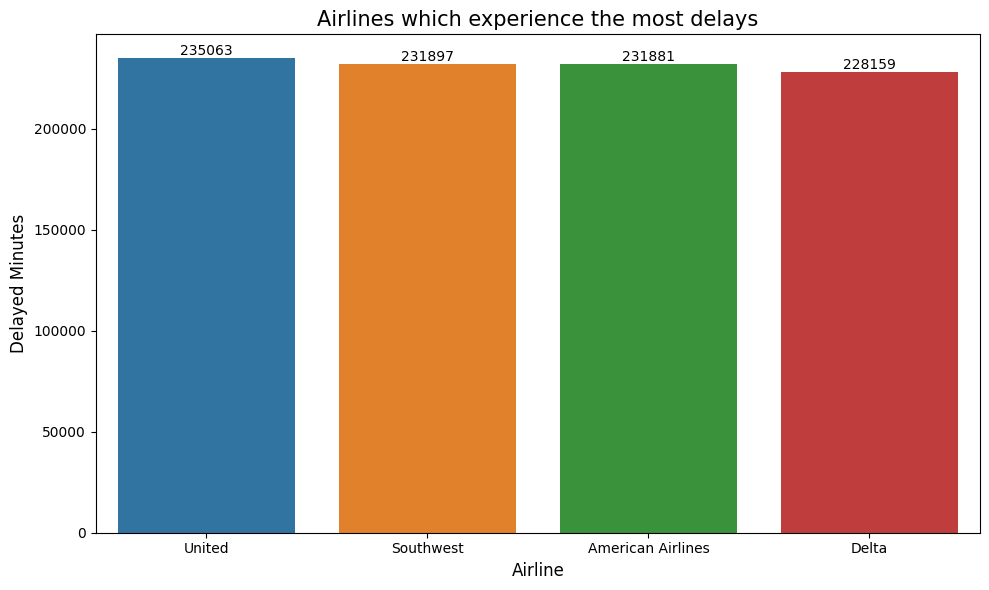

In [82]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='Airline',y='DelayMinutes',data=airline_delays)

plt.bar_label(ax.containers[0],fontsize=10)
plt.xlabel('Airline', fontsize=12)
plt.ylabel('Delayed Minutes', fontsize=12)
plt.title('Airlines which experience the most delays', fontsize=15)
plt.tight_layout()

# Display
plt.show()

## Infernece
#### United Airlines has the highest total delay minutes, followed closely by Southwest Airlines and American Airlines, with Delta having the lowest delay minutes among them. This indicates that delays are a common issue across all four airlines, though Delta performs slightly better in minimizing delays.

### 2. What are the most common reasons for flight delays?

In [83]:
Delayed_flights=data[data['DelayMinutes'] > 0]
# Delayed_flights
Delayed_reasons=Delayed_flights['DelayReason'].value_counts().reset_index()
# Delayed_reasons

Delayed_reasons.columns=['Delayed_reasons','Count']   # to change the heading of the column 
Delayed_reasons

,Delayed_reasons,Count
0,Weather,20094
1,Maintenance,20068
2,Air Traffic Control,19838


In [84]:
Delayed_reasons=Delayed_reasons.sort_values(by='Count',ascending=False)
Delayed_reasons

,Delayed_reasons,Count
0,Weather,20094
1,Maintenance,20068
2,Air Traffic Control,19838


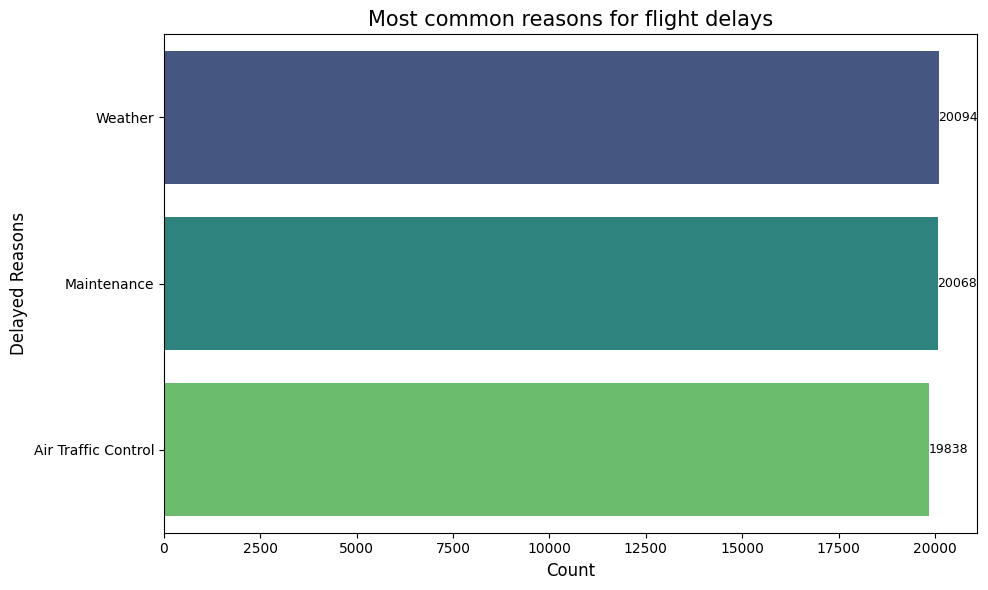

In [85]:
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='Count', y='Delayed_reasons', data=Delayed_reasons, palette='viridis')

plt.bar_label(ax.containers[0],fontsize=9)
plt.xlabel('Count', fontsize=12)
plt.ylabel('Delayed Reasons', fontsize=12)
plt.title('Most common reasons for flight delays', fontsize=15)
plt.tight_layout()

# Display
plt.show()

## Infernece
#### The data shows that weather is the leading cause of delays with 20,094 instances, followed closely by maintenance issues with 20,068 delays, and air traffic control with 19,838 delays. This indicates that external factors like weather and air traffic control, along with internal factors like maintenance, all contribute significantly to flight delays, with each cause occurring at relatively similar rates.

### 3. How frequently are flights delayed due to maintenance versus other reasons?

In [86]:
flights_delayed = data[data['DelayMinutes'] > 0]


Maintenance_delays= flights_delayed[flights_delayed['DelayReason'] == 'Maintenance']
Other_delays= flights_delayed[flights_delayed['DelayReason'] != 'Maintenance']

Delay_counts=pd.DataFrame({
    'Reasons': ['Maintenance','Other_days'],
    'Count': [len(Maintenance_delays),len(Other_delays)]
})
Delay_counts

,Reasons,Count
0,Maintenance,20068
1,Other_days,39932


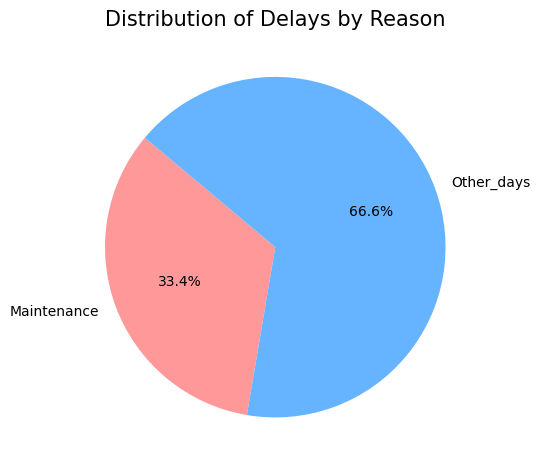

In [87]:
# plt.figure(figsize=(5, 3))  # Set the figure size
plt.pie(Delay_counts['Count'], 
        labels=Delay_counts['Reasons'], 
        autopct='%1.1f%%',  # Display percentages
        startangle=140,  # Start angle for the first slice
        colors=['#ff9999','#66b3ff','#99ff99','#ffcc99'])


plt.title('Distribution of Delays by Reason', fontsize=15)

# Show the Plot
plt.tight_layout()  # Optional: Adjust layout to fit
plt.show()

## Inference
#### The data shows that delays due to maintenance occurred 20,068 times, while delays classified as other reasons occurred nearly twice as often, with 39,932 instances. This suggests that while maintenance is a significant cause, a broader range of other, unspecified factors play a larger role in causing delays.

### 4. Do certain times of the day have higher delays?

In [88]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


data['ScheduledDeparture'] = pd.to_datetime(data['ScheduledDeparture'])


data['DepartureHour'] = data['ScheduledDeparture'].dt.hour


delayed_flights = data[data['DelayMinutes'] > 0]


#  Group by the hour of departure and calculate the average delay minutes
hourly_delays = delayed_flights.groupby('DepartureHour')['DelayMinutes'].mean().reset_index()
print(hourly_delays)

    DepartureHour  DelayMinutes
0               0     15.271748
1               1     15.396346
2               2     15.494465
3               3     15.562210
4               4     15.389988
5               5     15.339265
6               6     15.669639
7               7     15.520696
8               8     15.647392
9               9     15.403612
10             10     15.571372
11             11     15.447358
12             12     15.634940
13             13     15.264596
14             14     15.717139
15             15     15.337264
16             16     15.410686
17             17     15.627153
18             18     15.207390
19             19     15.280608
20             20     15.108076
21             21     15.287993
22             22     15.547819
23             23     15.649171


C:\Users\hp\AppData\Local\Temp\ipykernel_4584\2742985921.py:2: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(x='DepartureHour', y='DelayMinutes', data=hourly_delays, marker='o', palette='viridis')


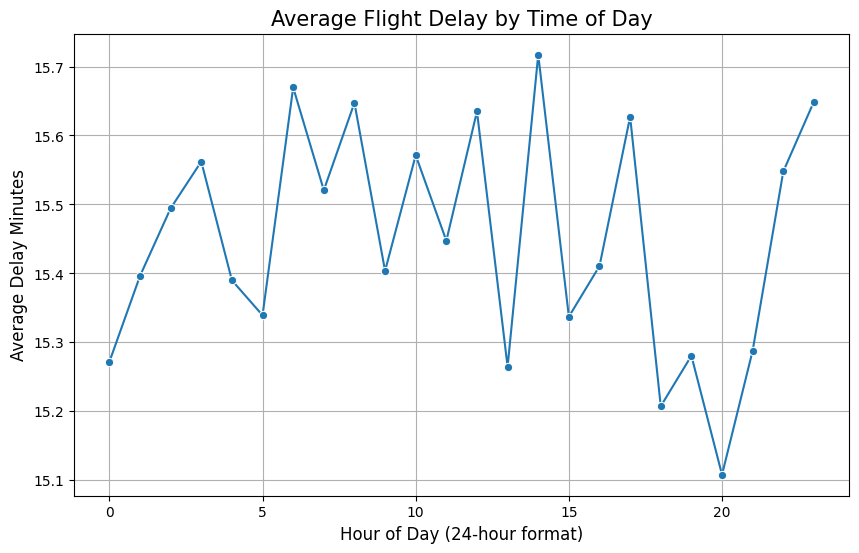

In [89]:
plt.figure(figsize=(10, 6))
sns.lineplot(x='DepartureHour', y='DelayMinutes', data=hourly_delays, marker='o', palette='viridis')

# Adding labels and titles
plt.xlabel('Hour of Day (24-hour format)', fontsize=12)
plt.ylabel('Average Delay Minutes', fontsize=12)
plt.title('Average Flight Delay by Time of Day', fontsize=15)
plt.grid(True)

# Display
plt.show()

## Inference
##### The data indicates that certain hours of the day experience slightly higher delays, with peak delay minutes observed around 14:00 (15.72 minutes), 22:00 (15.55 minutes), and 10:00 (15.57 minutes). While the variations in delay times across different hours are relatively minor, these slight peaks may suggest higher traffic or operational constraints during these periods. Overall, delays are consistent throughout the day, with only small fluctuations in average delay minutes across different hours. 

### 5. Are longer flights more prone to delays than shorter flights?

In [90]:
data['FlightCategory'] = data['Distance'].apply(lambda x: 'Short' if x <= 500 else 'Medium' if x <= 1500 else 'Long')
# data['FlightCategory']

delayed_flights = data[data['DelayMinutes'] > 0]


delay_by_category = delayed_flights.groupby('FlightCategory')['DelayMinutes'].mean().reset_index()
delay_by_category

,FlightCategory,DelayMinutes
0,Long,15.407796
1,Medium,15.519402
2,Short,15.434840


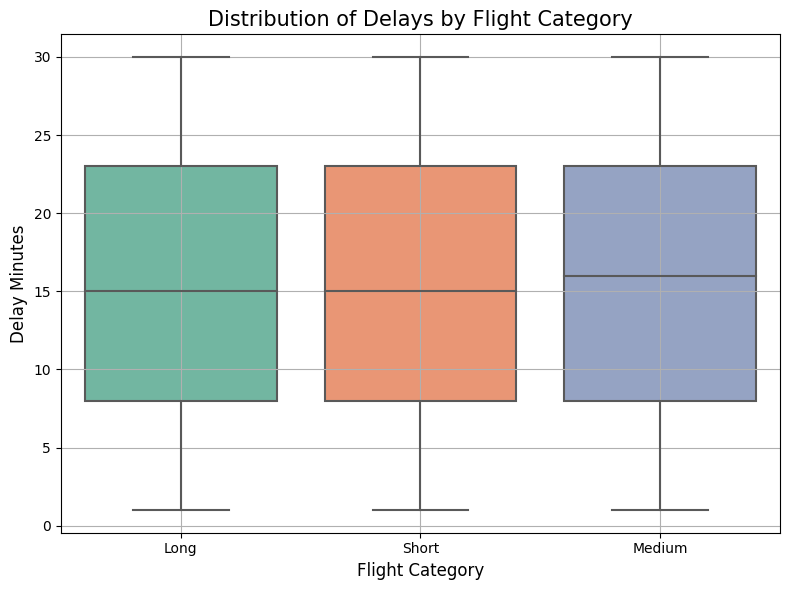

In [91]:
plt.figure(figsize=(8, 6))
sns.boxplot(x='FlightCategory', y='DelayMinutes', data=delayed_flights, palette='Set2')

# Customize the plot
plt.xlabel('Flight Category', fontsize=12)
plt.ylabel('Delay Minutes', fontsize=12)
plt.title('Distribution of Delays by Flight Category', fontsize=15)
plt.grid(True)
plt.tight_layout()

plt.show()

### Inference
##### The data shows that medium-length flights experience the highest average delay minutes (15.52 minutes), followed closely by short flights (15.43 minutes) and long flights (15.41 minutes). This suggests that medium-length flights may be slightly more prone to delays, although the difference in delay times across flight lengths is minimal, indicating that flight duration alone does not strongly influence delay likelihood.

### 5. Are international flights more delayed than domestic flights?

In [92]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Create a new column for flight type
data['FlightType'] = data.apply(lambda x: 'Domestic' if x['Origin'] == x['Destination'] else 'International', axis=1)

# Filter for delayed flights (where DelayMinutes > 0)
delayed_flights = data[data['DelayMinutes'] > 0]

# Group by FlightType and calculate the average delay minutes
delay_by_flight_type = delayed_flights.groupby('FlightType')['DelayMinutes'].mean().reset_index()
delay_by_flight_type

,FlightType,DelayMinutes
0,Domestic,15.369881
1,International,15.453152


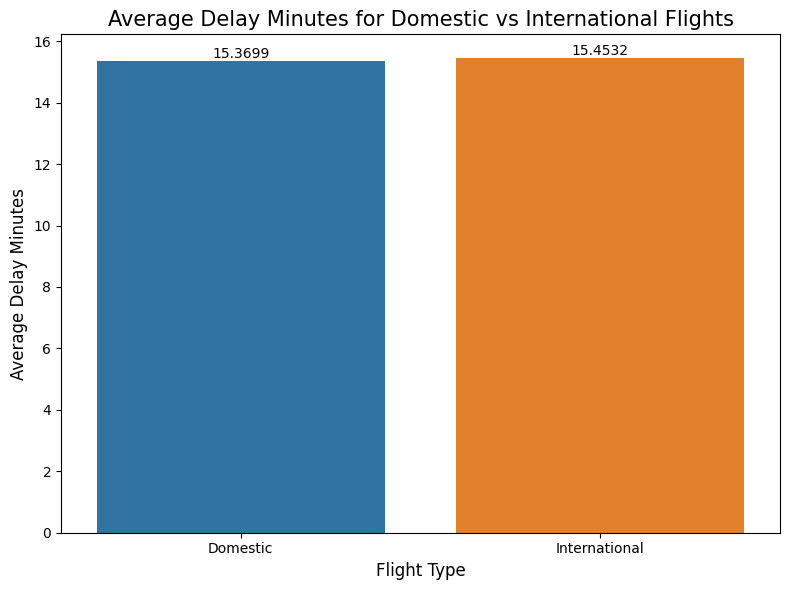

In [93]:
# Visualize the comparison with a bar plot
plt.figure(figsize=(8, 6))
ax = sns.barplot(x='FlightType', y='DelayMinutes', data=delay_by_flight_type)

# Customize the plot
plt.bar_label(ax.containers[0],fontsize=10)
plt.xlabel('Flight Type', fontsize=12)
plt.ylabel('Average Delay Minutes', fontsize=12)
plt.title('Average Delay Minutes for Domestic vs International Flights', fontsize=15)
plt.tight_layout()

# Show the plot
plt.show()

### Inference
##### The data shows that international flights have a slightly higher average delay (15.45 minutes) compared to domestic flights (15.37 minutes). This small difference suggests that while international flights may experience marginally more delays, the delay disparity between domestic and international flights is minimal, indicating that flight type alone does not significantly impact delay times.

### 6. Do certain airports have higher delays compared to others?

In [94]:
# Filter for delayed flights (where DelayMinutes > 0)
delayed_flights = data[data['DelayMinutes'] > 0]

# Group by the airport and calculate the average delay minutes
delay_by_airport = delayed_flights.groupby('Origin')['DelayMinutes'].mean().reset_index()

# Sort airports by the average delay minutes
delay_by_airport = delay_by_airport.sort_values(by='DelayMinutes', ascending=False)
delay_by_airport

,Origin,DelayMinutes
4,ORD,15.594006
2,JFK,15.489487
0,ATL,15.443156
3,LAX,15.362672
1,DFW,15.359775


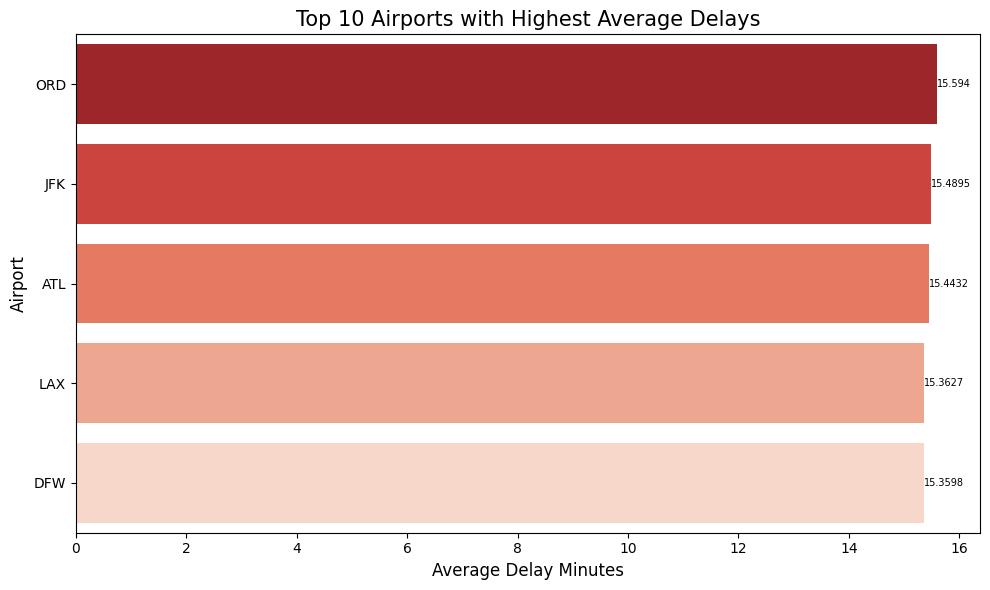

In [95]:
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='DelayMinutes', y='Origin', data=delay_by_airport.head(10), palette='Reds_r')

# Customize the plot
plt.bar_label(ax.containers[0],fontsize=7)
plt.xlabel('Average Delay Minutes', fontsize=12)
plt.ylabel('Airport', fontsize=12)
plt.title('Top 10 Airports with Highest Average Delays', fontsize=15)
plt.tight_layout()

# Show the plot
plt.show()

### Inference
##### The data indicates that flights originating from ORD (Chicago O'Hare) experience the highest average delay (15.59 minutes), followed by JFK (New York) at 15.49 minutes. ATL (Atlanta), LAX (Los Angeles), and DFW (Dallas-Fort Worth) show progressively lower average delays, with DFW having the lowest at 15.36 minutes. This suggests that ORD and JFK may have more frequent or longer delays compared to the other airports, potentially due to higher traffic volumes or operational challenges at these hubs.

### 7. What percentage of flights are canceled or diverted across different airlines?

In [96]:
airline_flight_stats = data.groupby('Airline').agg(
    TotalFlights=('FlightID', 'count'),  
    CanceledFlights=('Cancelled', 'sum'),  
    DivertedFlights=('Diverted', 'sum')  
).reset_index()
airline_flight_stats

,Airline,TotalFlights,CanceledFlights,DivertedFlights
0,American Airlines,15061,7457,7593
1,Delta,14734,7354,7320
2,Southwest,14995,7349,7497
3,United,15210,7531,7578


In [97]:
airline_flight_stats['CancelPercentage'] = (airline_flight_stats['CanceledFlights'] / airline_flight_stats['TotalFlights']) * 100

airline_flight_stats['DivertPercentage'] = (airline_flight_stats['DivertedFlights'] / airline_flight_stats['TotalFlights']) * 100

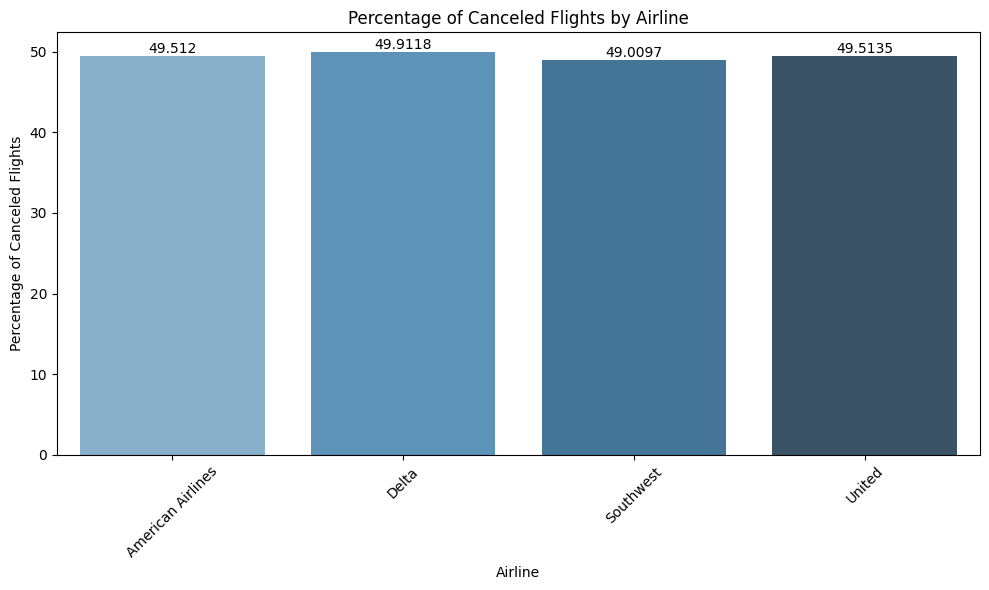

In [98]:
# Visualize the percentage of diverted flights across airlines
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='Airline', y='CancelPercentage', data=airline_flight_stats, palette='Blues_d')
plt.bar_label(ax.containers[0],fontsize=10)
plt.title('Percentage of Canceled Flights by Airline')
plt.xlabel('Airline')
plt.ylabel('Percentage of Canceled Flights')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

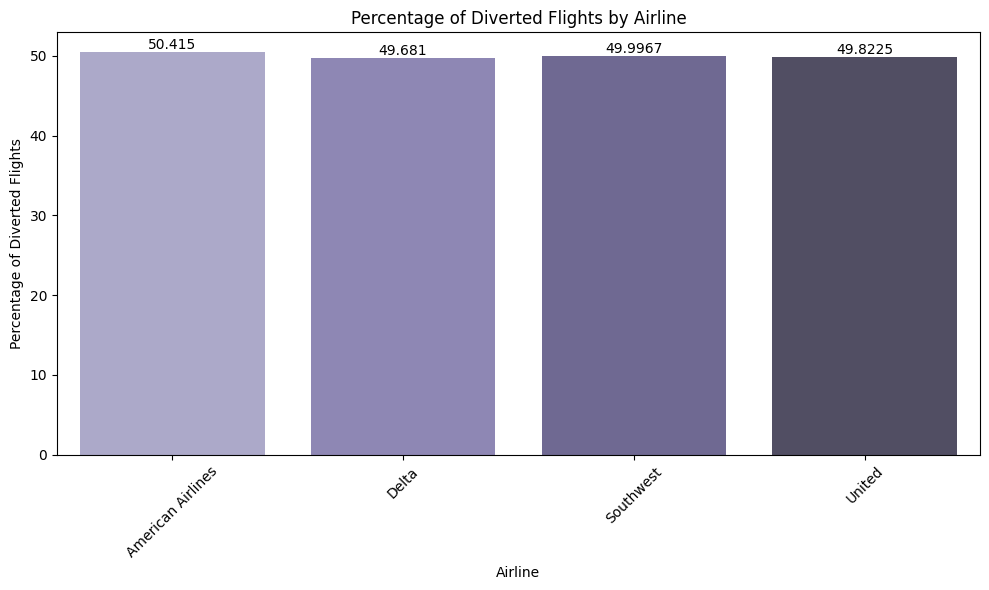

In [99]:
# Visualize the percentage of cancelled flights across airlines
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='Airline', y='DivertPercentage', data=airline_flight_stats, palette='Purples_d')
plt.bar_label(ax.containers[0],fontsize=10)
plt.title('Percentage of Diverted Flights by Airline')
plt.xlabel('Airline')
plt.ylabel('Percentage of Diverted Flights')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#### Inference
##### The data shows that American Airlines has the highest number of canceled (7,457) and diverted flights (7,593) out of a total of 15,061 flights. United follows closely with similar figures, having 7,531 canceled and 7,578 diverted flights out of 15,210 total flights. Delta and Southwest also display similar patterns, with Delta having slightly fewer cancellations and diversions compared to the others.

### 8. What are the most common causes of delays for flights departing from major airports?

In [100]:
# Group the airport and delay reason, then count occurrences
delay_causes_by_airport = data.groupby(['Origin', 'DelayReason']).size().reset_index(name='Count')

#  sorting the values
elay_causes_by_airport = delay_causes_by_airport.sort_values(by=['Origin', 'Count'], ascending=[True, False])
print(delay_causes_by_airport)

   Origin          DelayReason  Count
0     ATL  Air Traffic Control   3999
1     ATL          Maintenance   4055
2     ATL              Weather   4023
3     DFW  Air Traffic Control   3860
4     DFW          Maintenance   4014
5     DFW              Weather   4014
6     JFK  Air Traffic Control   3955
7     JFK          Maintenance   3955
8     JFK              Weather   3980
9     LAX  Air Traffic Control   4080
10    LAX          Maintenance   4019
11    LAX              Weather   3967
12    ORD  Air Traffic Control   3944
13    ORD          Maintenance   4025
14    ORD              Weather   4110


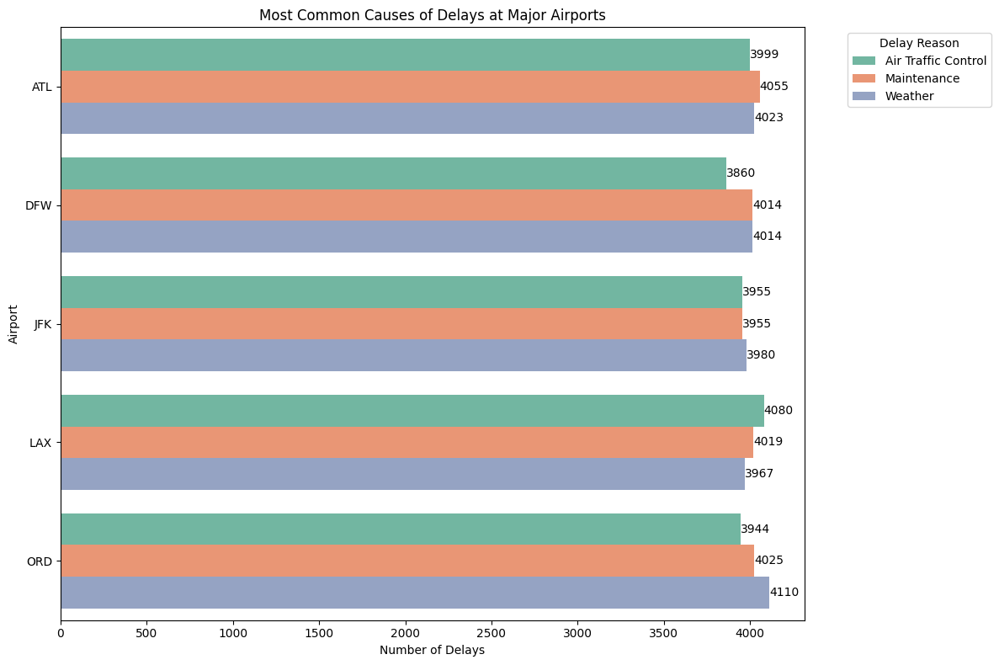

In [101]:
plt.figure(figsize=(12, 8))
ax = sns.barplot(x='Count', y='Origin', hue='DelayReason', data=delay_causes_by_airport, palette='Set2')
plt.bar_label(ax.containers[0],fontsize=10)
plt.bar_label(ax.containers[1],fontsize=10)
plt.bar_label(ax.containers[2],fontsize=10)
plt.title('Most Common Causes of Delays at Major Airports')
plt.xlabel('Number of Delays')
plt.ylabel('Airport')
plt.legend(title='Delay Reason', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Show the plot
plt.show()

#### Inference
##### The data reveals that maintenance is the leading cause of delays across all five airports (ATL, DFW, JFK, LAX, ORD), with counts ranging from 4,014 to 4,055. Air traffic control and weather also significantly contribute to delays, with counts fluctuating around 3,900 to 4,080. Notably, LAX has the highest number of delays due to air traffic control at 4,080, while ORD experiences the highest weather-related delays at 4,110

### 9. Which aircraft types are more prone to delays?

In [102]:
delayed_flights = data[data['DelayMinutes'] > 0]

# Group by aircraft type and calculate the average delay
delay_by_aircraft = delayed_flights.groupby('AircraftType')['DelayMinutes'].mean().reset_index()

# Step 4: Sort the data to show aircraft types with highest average delay first
delay_by_aircraft = delay_by_aircraft.sort_values(by='DelayMinutes', ascending=False)

# Display the result
print(delay_by_aircraft.head())

  AircraftType  DelayMinutes
0  Airbus A320     15.482183
1   Boeing 737     15.460209
2   Boeing 777     15.408646


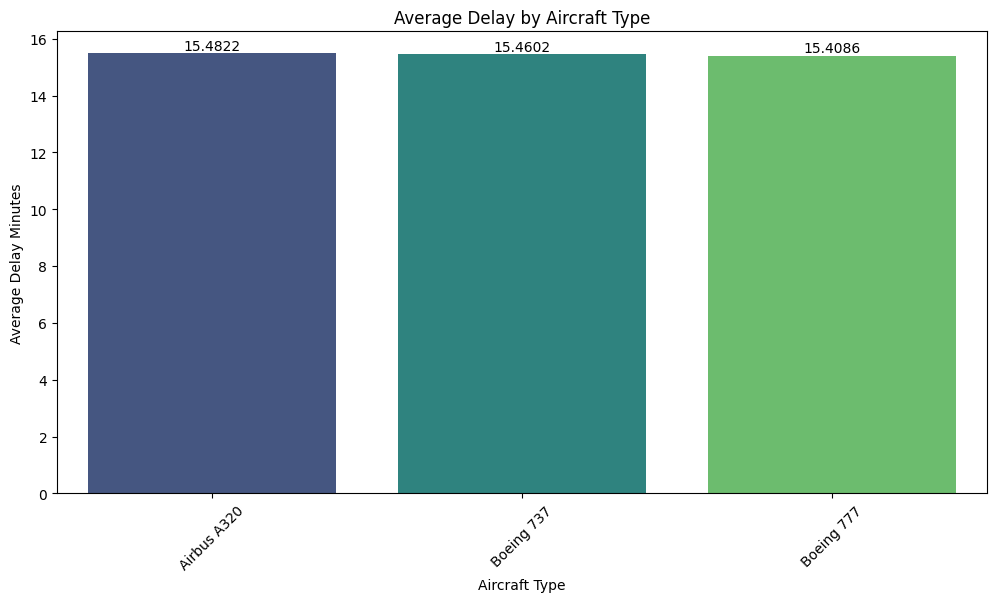

In [103]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot the average delay per aircraft type
plt.figure(figsize=(12, 6))
ax = sns.barplot(x='AircraftType', y='DelayMinutes', data=delay_by_aircraft, palette='viridis')
plt.bar_label(ax.containers[0],fontsize=10)
plt.title('Average Delay by Aircraft Type')
plt.xlabel('Aircraft Type')
plt.ylabel('Average Delay Minutes')
plt.xticks(rotation=45)
plt.show()

### Inference
##### The data indicates that Airbus A320 aircraft experience the highest average delay minutes at 15.48, followed closely by Boeing 737 at 15.46 minutes, and Boeing 777 with the lowest average delay of 15.41 minutes. This suggests that while all three aircraft types have relatively similar delay times, the Airbus A320 may be slightly more prone to delays compared to the others, though the differences are minimal.

### 10. Does the time between scheduled and actual departure time vary by airline?

In [104]:
data['ScheduledDeparture'] = pd.to_datetime(data['ScheduledDeparture'])
data['ActualDeparture'] = pd.to_datetime(data['ActualDeparture'])

# Calculate departure delay in minutes
data['DepartureDelay'] = (data['ActualDeparture'] - data['ScheduledDeparture']).dt.total_seconds() / 60

# Group by airline and calculate the average departure delay
departure_delay_by_airline = data.groupby('Airline')['DepartureDelay'].mean().reset_index()

# Sort results by highest average delay
departure_delay_by_airline = departure_delay_by_airline.sort_values(by='DepartureDelay', ascending=False)

# Display the result
print(departure_delay_by_airline)

             Airline  DepartureDelay
3             United       15.006443
1              Delta       14.938985
0  American Airlines       14.889914
2          Southwest       14.804935


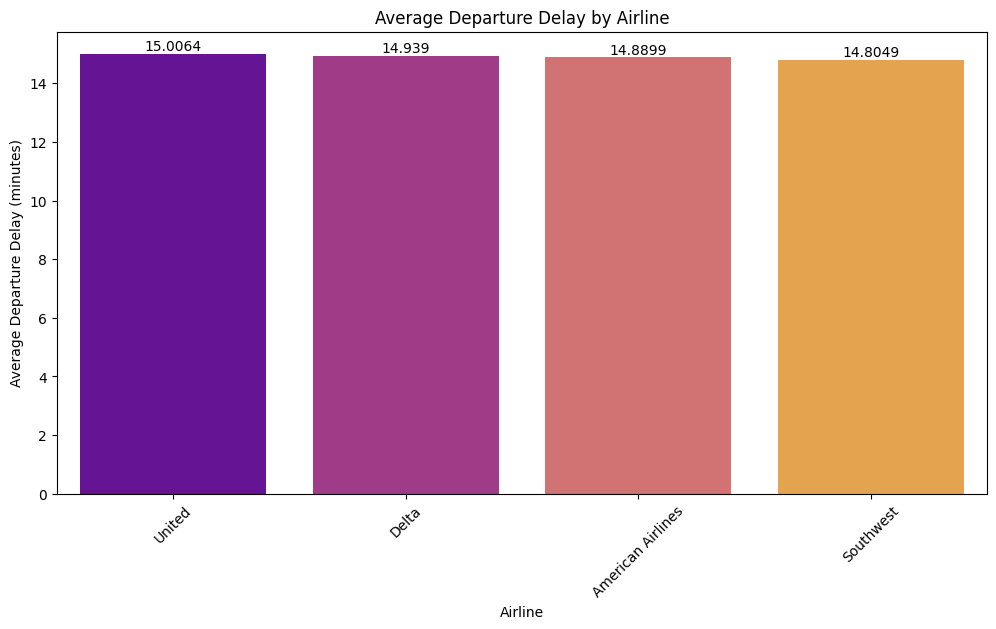

In [105]:
plt.figure(figsize=(12, 6))
ax = sns.barplot(x='Airline', y='DepartureDelay', data=departure_delay_by_airline, palette='plasma')
plt.bar_label(ax.containers[0],fontsize=10)
plt.title('Average Departure Delay by Airline')
plt.xlabel('Airline')
plt.ylabel('Average Departure Delay (minutes)')
plt.xticks(rotation=45)
plt.show()

### Inference
##### The data shows that United Airlines has the highest average departure delay at 15.01 minutes, followed closely by Delta with an average of 14.94 minutes. American Airlines and Southwest have slightly lower average delays, at 14.89 and 14.80 minutes, respectively. This indicates that United Airlines may experience more frequent or longer departure delays compared to the other airlines, while all airlines have relatively similar performance regarding departure timeliness.

## CONCLUSION
##### This project successfully analyzes flight delay patterns, uncovering insights into the factors that contribute to delays, cancellations, and diversions. By exploring variables like airline, airport, and delay causes, the analysis highlights significant trends and correlations that can aid in identifying high-risk delay scenarios. This information can be valuable for stakeholders in making data-driven decisions to improve flight scheduling and operational efficiency. Further exploration could include predictive modeling to forecast delays based on historical data, enhancing proactive measures in flight management systems.